In [1]:
import pandas as pd
import numpy as np

In [2]:
df=pd.read_hdf('./data/tables_of_fgm.H5')
df.columns

Index(['zeta', 'f', 'pv', 'C2H3', 'C2H6', 'CH2', 'H2CN', 'C2H4', 'H2O2', 'C2H',
       'CN', 'heatRelease', 'NCO', 'NNH', 'N2', 'AR', 'psi', 'CO', 'CH4',
       'HNCO', 'CH2OH', 'HCCO', 'CH2CO', 'CH', 'mu', 'C2H2', 'C2H5', 'H2', 'T',
       'PVs', 'O', 'O2', 'N2O', 'C', 'C3H7', 'CH2(S)', 'NH3', 'HO2', 'NO',
       'HCO', 'NO2', 'OH', 'HCNO', 'CH3CHO', 'CH3', 'NH', 'alpha', 'CH3O',
       'CO2', 'CH3OH', 'CH2CHO', 'CH2O', 'C3H8', 'HNO', 'NH2', 'HCN', 'H', 'N',
       'H2O', 'HCCOH', 'HCNN'],
      dtype='object')

In [3]:
# Plotly
import plotly.offline as pyoff
import plotly.tools as tls
import pandas as pd

In [6]:
df_s=df.sample(frac=0.1)
sp='CH4'
fig_db = {
    'data': [
        {
         'x': df_s['f'],
         'y': df_s['pv'],
         'z': df_s[sp],
         'type':'scatter3d', 
        'mode': 'markers',
          'marker':{
              'size':1
          }
        }
        
    ],
    'layout': {
         'scene':{
             'xaxis':{'title':'mixture fraction'},
        'yaxis': {'title': "progress variable"},
         'zaxis': {'title': sp}
                 }
    }
}
pyoff.iplot(fig_db, filename='multiple-scatter')

In [5]:
f_st = 0.055
ox_ratio = 0.232
N2_ratio = 1-ox_ratio
CH4_ratio = 1
T0 = T1 = 300
cp0 = 1009.87
cp1 = 2229.16
rho0 = 1.15689
rho1 = 0.643146
viscosity0 =1.86347E-05
viscosity1 =1.14597E-05
thermalConductivity0 = 0.0252614
thermalConductivity1 = 0.0326731

pvs=np.linspace(df['PV'].min(),df['PV'].max(),100)

In [6]:
df_bc_0=pd.DataFrame()
df_bc_1=pd.DataFrame()

In [7]:
df_bc_0['PV']=pvs
df_bc_0['f']=0
df_bc_0['T']=T0
df_bc_0['O2']=ox_ratio
df_bc_0['N2']=1-ox_ratio
df_bc_0['CH4']=0
df_bc_0['cp']=cp0
df_bc_0['rho']=rho0
df_bc_0['viscosity']=viscosity0
df_bc_0['thermalConductivity']=thermalConductivity0

In [8]:
rest_sp_0=df.columns.drop(set(df_bc_0.columns))
for sp in rest_sp_0:
    df_bc_0[sp]=0

In [9]:
df_bc_1['PV']=pvs
df_bc_1['f']=1
df_bc_1['T']=T1
df_bc_1['O2']=0
df_bc_1['N2']=0
df_bc_1['CH4']=1
df_bc_1['cp']=cp1
df_bc_1['rho']=rho1
df_bc_1['viscosity']=viscosity1
df_bc_1['thermalConductivity']=thermalConductivity1

In [10]:
rest_sp_1=df.columns.drop(set(df_bc_1.columns))
for sp in rest_sp_1:
    df_bc_1[sp]=0

In [20]:
df_new=df
df_new=pd.concat((df_new,df_bc_0),sort=False)
df_new=pd.concat((df_new,df_bc_1),sort=False)

In [21]:
sp='T'
df_show=df_new
fig_db = {
    'data': [
        {
            'name':'data_org',
         'x': df_show['f'],
         'y': df_show['PV'],
         'z': df_show[sp],
         'type':'scatter3d', 
        'mode': 'markers',
          'marker':{
              'size':1
          }
        }     
    ],
    'layout': {
         'scene':{
             'xaxis':{'title':'mixture fraction'},
        'yaxis': {'title': "progress variable"},
         'zaxis': {'title': sp}
                 }
    }
}
pyoff.iplot(fig_db, filename='multiple-scatter')

In [40]:
from scipy.interpolate import griddata
sp='T'
x=df_new['f']
y=df_new['PV']
z=df_new[sp]
resX=200
resY=200
xi = np.linspace(min(x), max(x), resX)
yi = np.linspace(min(y), max(y), resY)
grid_x,grid_y = np.meshgrid(xi,yi)

Z = griddata(df_new[['f','PV']],df_new[sp], (grid_x, grid_y), method='linear')


In [41]:
import plotly.graph_objs as go
data=[
    go.Contour(
    z=np.nan_to_num(Z),
    x=xi,
    y=yi    
    )
]
pyoff.iplot(data)

In [24]:
fig_db = {
    'data': [
        {
         'name':'data_org',
         'x': df_show['f'],
         'y': df_show['PV'],
         'z': df_show[sp],
         'type':'scatter3d', 
        'mode': 'markers',
          'marker':{
              'size':1
          }
        },
        {
         'name':'data_interplation',
         'x':grid_x.reshape(-1),
         'y': grid_y.reshape(-1),
         'z': Z.reshape(-1),
         'type':'scatter3d', 
        'mode': 'markers',
          'marker':{
              'size':1
          }
        }
        
    ],
    'layout': {
         'scene':{
             'xaxis':{'title':'mixture fraction'},
             'yaxis': {'title': "progress variable"},
             'zaxis': {'title': sp}
                 }
    }
}
pyoff.iplot(fig_db, filename='multiple-scatter')

In [64]:
from scipy.interpolate import griddata
df_interpolation=pd.DataFrame()
x=df_new['f']
y=df_new['PV']
resX=100
resY=100
xi = np.linspace(min(x), max(x), resX)
yi = np.linspace(min(y), max(y), resY)

grid_x,grid_y = np.meshgrid(xi,yi)
df_interpolation['f']=grid_x.reshape(-1)
df_interpolation['PV']=grid_y.reshape(-1)
for sp in df.columns:
    z=df_new[sp]
    Z = griddata(df_new[['f','PV']],df_new[sp], (grid_x, grid_y), method='linear')
    df_interpolation[sp]=Z.reshape(-1)
    

In [66]:
sp='T'
df_show=df_interpolation.sample(frac=0.5)
fig_db = {
    'data': [
        {
            'name':'data_org',
         'x': df_show['f'],
         'y': df_show['PV'],
         'z': df_show[sp],
         'type':'scatter3d', 
        'mode': 'markers',
          'marker':{
              'size':1
          }
        }     
    ],
    'layout': {
         'scene':{
             'xaxis':{'title':'mixture fraction'},
        'yaxis': {'title': "progress variable"},
         'zaxis': {'title': sp}
                 }
    }
}
pyoff.iplot(fig_db, filename='multiple-scatter')

In [72]:
df_interpolation['T'].max()

2176.804598393099

In [75]:
xi

array([0.        , 0.01010101, 0.02020202, 0.03030303, 0.04040404,
       0.05050505, 0.06060606, 0.07070707, 0.08080808, 0.09090909,
       0.1010101 , 0.11111111, 0.12121212, 0.13131313, 0.14141414,
       0.15151515, 0.16161616, 0.17171717, 0.18181818, 0.19191919,
       0.2020202 , 0.21212121, 0.22222222, 0.23232323, 0.24242424,
       0.25252525, 0.26262626, 0.27272727, 0.28282828, 0.29292929,
       0.3030303 , 0.31313131, 0.32323232, 0.33333333, 0.34343434,
       0.35353535, 0.36363636, 0.37373737, 0.38383838, 0.39393939,
       0.4040404 , 0.41414141, 0.42424242, 0.43434343, 0.44444444,
       0.45454545, 0.46464646, 0.47474747, 0.48484848, 0.49494949,
       0.50505051, 0.51515152, 0.52525253, 0.53535354, 0.54545455,
       0.55555556, 0.56565657, 0.57575758, 0.58585859, 0.5959596 ,
       0.60606061, 0.61616162, 0.62626263, 0.63636364, 0.64646465,
       0.65656566, 0.66666667, 0.67676768, 0.68686869, 0.6969697 ,
       0.70707071, 0.71717172, 0.72727273, 0.73737374, 0.74747

In [83]:
pv_index=df_interpolation.loc[df_interpolation['PV']==11.796433734589966].index
fst_index=df_interpolation.loc[df_interpolation['f']==xi[5]].index

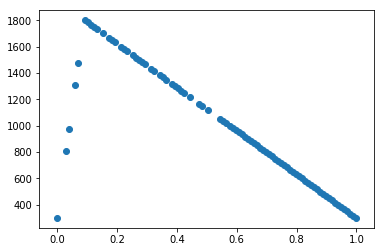

In [71]:
import matplotlib.pyplot as plt
plt.scatter(df_interpolation.loc[pv_index]['f'],df_interpolation.loc[pv_index]['T'])

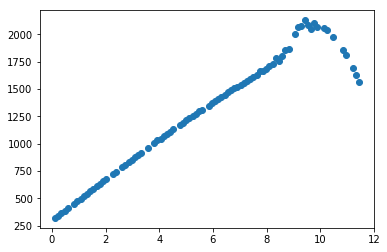

In [85]:
plt.scatter(df_interpolation.loc[fst_index]['PV'],df_interpolation.loc[fst_index]['T'])

In [79]:
pv_index

Int64Index([9900, 9903, 9904, 9906, 9907, 9909, 9910, 9911, 9912, 9913, 9915,
            9917, 9918, 9919, 9921, 9922, 9923, 9925, 9926, 9927, 9928, 9929,
            9931, 9932, 9934, 9935, 9936, 9938, 9939, 9940, 9941, 9942, 9944,
            9947, 9948, 9950, 9954, 9955, 9956, 9957, 9958, 9959, 9960, 9961,
            9962, 9963, 9964, 9965, 9966, 9967, 9968, 9969, 9970, 9971, 9972,
            9973, 9974, 9975, 9976, 9977, 9978, 9979, 9980, 9981, 9982, 9983,
            9984, 9985, 9986, 9987, 9988, 9989, 9990, 9991, 9992, 9993, 9994,
            9995, 9996, 9997, 9998, 9999],
           dtype='int64')

In [81]:
sum(df_interpolation['f']==0.05050505)

0

In [84]:
xi[5]

0.05050505050505051